In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Graph attention network (GAT) for node classification


### Import packages

In [2]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import pandas as pd
import os
from tqdm import tqdm
import keras
from keras import initializers

keras.utils.set_random_seed(812)

# If using TensorFlow, this will make GPU ops as deterministic as possible,
# but it will affect the overall performance, so be mindful of that.
tf.config.experimental.enable_op_determinism()

## Obtain the dataset


In [3]:
dataset = pd.read_csv('/content/drive/MyDrive/dataset_saved.csv')
similarity_df = pd.read_csv('/content/drive/MyDrive/similar_pairs_filtered_all.csv')

In [4]:
class_values = sorted(dataset["label"].unique())
class_idx = {name: id for id, name in enumerate(class_values)}
image_idx = {name: idx for idx, name in enumerate(sorted(dataset["imagepath"].unique()))}

dataset["imagepath"] = dataset["imagepath"].apply(lambda name: image_idx[name])
similarity_df["imagepath1"] = similarity_df["imagepath1"].apply(lambda name: image_idx[name])
similarity_df["imagepath2"] = similarity_df["imagepath2"].apply(lambda name: image_idx[name])
dataset["label"] = dataset["label"].apply(lambda value: class_idx[value])

In [5]:
dataset

,imagepath,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,...,feature991,feature992,feature993,feature994,feature995,feature996,feature997,feature998,feature999,label
0,139,3.389323e-06,4.759926e-05,1.662880e-04,4.047400e-04,5.198935e-05,3.044088e-05,4.825750e-05,2.889475e-06,4.268156e-06,...,4.559593e-06,1.440692e-05,6.691741e-07,4.703142e-06,4.584608e-06,0.000207,4.828837e-06,0.000695,0.006473,0
1,34,7.453763e-07,3.533396e-06,1.208046e-05,5.711770e-06,6.607552e-06,1.633703e-06,1.227097e-06,1.371299e-06,2.919434e-07,...,9.092418e-07,1.054092e-06,1.705929e-07,2.164688e-07,2.313551e-06,0.000064,9.954320e-07,0.000531,0.000581,0
2,224,9.080426e-09,7.984064e-07,3.702929e-08,5.094595e-07,1.947281e-07,2.322111e-07,3.139065e-08,6.140245e-09,4.737616e-09,...,1.445131e-07,1.913998e-07,2.722386e-08,1.262127e-06,1.442970e-07,0.000010,1.421237e-07,0.000035,0.000003,0
3,132,1.127597e-06,1.716406e-05,4.326875e-05,1.378049e-04,6.536945e-05,1.707065e-05,1.241560e-05,2.042372e-06,7.547025e-07,...,3.851757e-06,4.335804e-06,7.493072e-07,6.244837e-06,1.353363e-06,0.000052,6.707935e-06,0.000932,0.000555,0
4,5,1.415887e-05,3.753336e-05,6.040844e-05,8.895748e-05,1.370191e-04,1.470743e-05,1.923864e-05,5.245407e-06,3.143040e-06,...,1.210680e-05,6.718504e-06,2.951771e-06,6.325793e-06,2.030865e-05,0.000160,5.171881e-06,0.001192,0.003400,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5870,4403,3.123997e-05,5.051630e-05,2.118235e-03,1.324212e-03,1.110293e-03,2.256231e-05,6.527601e-05,2.312667e-06,1.011734e-06,...,8.330099e-06,8.197332e-06,3.299098e-07,2.358278e-06,4.520241e-06,0.000165,8.706082e-06,0.002837,0.000754,1
5871,4856,9.908329e-06,3.737578e-05,1.882876e-03,1.110121e-03,6.821608e-04,1.819964e-04,2.592023e-04,7.292509e-06,7.293009e-06,...,1.682380e-05,2.021860e-05,1.466965e-06,6.365354e-06,9.434770e-06,0.000141,1.223626e-05,0.001955,0.005197,1
5872,3216,5.851964e-06,2.573696e-05,6.702321e-04,1.145046e-04,5.624614e-04,1.980242e-05,5.958289e-05,9.086167e-06,2.704184e-06,...,1.341714e-06,4.804325e-06,9.138102e-07,4.909081e-06,8.089466e-07,0.000016,3.531299e-06,0.000095,0.001215,1
5873,2946,5.879587e-05,5.516717e-05,2.092986e-03,2.715294e-03,3.773008e-03,5.763760e-05,1.968304e-04,8.835574e-06,3.424224e-06,...,6.975104e-06,1.277343e-05,3.500858e-07,7.738369e-06,3.451445e-06,0.000094,2.753402e-06,0.000235,0.002095,1


In [6]:
similarity_df

,imagepath1,imagepath2,similarity
0,139,138,1.000000
1,224,74,0.991863
2,224,201,0.999198
3,224,202,0.999198
4,224,118,0.999439
...,...,...,...
188870,3224,3913,0.990419
188871,5068,2438,0.984141
188872,5068,3913,0.983097
188873,2545,4953,0.992727


### Split the dataset

In [7]:
# Obtain random indices
random_indices = np.random.permutation(range(dataset.shape[0]))

# 50/50 split
train_data = dataset.iloc[random_indices[: len(random_indices) // 2]]
test_data = dataset.iloc[random_indices[len(random_indices) // 2 :]]

### Prepare the graph data

In [8]:
# Obtain paper indices which will be used to gather node states
# from the graph later on when training the model
train_indices = train_data["imagepath"].to_numpy()
test_indices = test_data["imagepath"].to_numpy()

# Obtain ground truth labels corresponding to each imagepath
train_labels = train_data["label"].to_numpy()
test_labels = test_data["label"].to_numpy()

# Define graph, namely an edge tensor and a node feature tensor
edges = tf.convert_to_tensor(similarity_df[["imagepath1", "imagepath2"]])
node_states = tf.convert_to_tensor(dataset.sort_values("imagepath").iloc[:, 1:-1])

# Print shapes of the graph
print("Edges shape:\t\t", edges.shape)
print("Node features shape:", node_states.shape)

Edges shape:		 (188875, 2)
Node features shape: (5875, 1000)


In [9]:
!pip install ipysigma

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 13.0 MB/s eta 0:00:00


In [10]:
from google.colab import output

output.enable_custom_widget_manager()

In [11]:
!pip install networkx ipysigma

In [12]:
import networkx as nx
from ipysigma import Sigma


# Create a graph
G = nx.Graph()

# Add nodes and edges to the graph based on the tensors
for edge in edges.numpy():
    G.add_edge(edge[0], edge[1])

# Create the Sigma widget for visualization
sigma = Sigma(graph=G)

# Display the graph
sigma

Sigma(nx.Graph with 2,534 nodes and 188,875 edges)

## Build the model

GAT takes as input a graph (namely an edge tensor and a node feature tensor) and
outputs \[updated\] node states. The node states are, for each target node, neighborhood
aggregated information of *N*-hops (where *N* is decided by the number of layers of the
GAT). Importantly, in contrast to the
[graph convolutional network](https://arxiv.org/abs/1609.02907) (GCN)
the GAT makes use of attention mechanisms
to aggregate information from neighboring nodes (or *source nodes*). In other words, instead of simply
averaging/summing node states from source nodes (*source papers*) to the target node (*target papers*),
GAT first applies normalized attention scores to each source node state and then sums.

In [13]:
class GraphAttention(layers.Layer):
    def __init__(
        self,
        units,
        kernel_regularizer=None,
        **kwargs,
    ):
        super().__init__(**kwargs)
        self.units = units
        self.kernel_initializer = initializers.GlorotUniform(seed=42)
        self.kernel_regularizer = keras.regularizers.get(kernel_regularizer)

    def build(self, input_shape):

        self.kernel = self.add_weight(
            shape=(input_shape[0][-1], self.units),
            trainable=True,
            initializer=self.kernel_initializer,
            regularizer=self.kernel_regularizer,
            name="kernel",
        )
        self.kernel_attention = self.add_weight(
            shape=(self.units * 2, 1),
            trainable=True,
            initializer=self.kernel_initializer,
            regularizer=self.kernel_regularizer,
            name="kernel_attention",
        )
        self.built = True

    def call(self, inputs):
        node_states, edges = inputs

        # Linearly transform node states
        node_states_transformed = tf.matmul(node_states, self.kernel)

        # (1) Compute pair-wise attention scores
        node_states_expanded = tf.gather(node_states_transformed, edges)
        node_states_expanded = tf.reshape(
            node_states_expanded, (tf.shape(edges)[0], -1)
        )
        attention_scores = tf.nn.leaky_relu(
            tf.matmul(node_states_expanded, self.kernel_attention)
        )
        attention_scores = tf.squeeze(attention_scores, -1)

        # (2) Normalize attention scores
        attention_scores = tf.math.exp(tf.clip_by_value(attention_scores, -2, 2))
        attention_scores_sum = tf.math.unsorted_segment_sum(
            data=attention_scores,
            segment_ids=edges[:, 0],
            num_segments=tf.reduce_max(edges[:, 0]) + 1,
        )
        attention_scores_sum = tf.repeat(
            attention_scores_sum, tf.math.bincount(tf.cast(edges[:, 0], "int32"))
        )
        attention_scores_norm = attention_scores / attention_scores_sum

        # (3) Gather node states of neighbors, apply attention scores and aggregate
        node_states_neighbors = tf.gather(node_states_transformed, edges[:, 1])
        out = tf.math.unsorted_segment_sum(
            data=node_states_neighbors * attention_scores_norm[:, tf.newaxis],
            segment_ids=edges[:, 0],
            num_segments=tf.shape(node_states)[0],
        )
        return out


class MultiHeadGraphAttention(layers.Layer):
    def __init__(self, units, num_heads=8, merge_type="concat", **kwargs):
        super().__init__(**kwargs)
        self.num_heads = num_heads
        self.merge_type = merge_type
        self.attention_layers = [GraphAttention(units) for _ in range(num_heads)]

    def call(self, inputs):
        atom_features, pair_indices = inputs

        # Obtain outputs from each attention head
        outputs = [
            attention_layer([atom_features, pair_indices])
            for attention_layer in self.attention_layers
        ]
        # Concatenate or average the node states from each head
        if self.merge_type == "concat":
            outputs = tf.concat(outputs, axis=-1)
        else:
            outputs = tf.reduce_mean(tf.stack(outputs, axis=-1), axis=-1)
        # Activate and return node states
        return tf.nn.relu(outputs)


### Implement training logic with custom `train_step`, `test_step`, and `predict_step` methods

Notice, the GAT model operates on the entire graph (namely, `node_states` and
`edges`) in all phases (training, validation and testing). Hence, `node_states` and
`edges` are passed to the constructor of the `keras.Model` and used as attributes.
The difference between the phases are the indices (and labels), which gathers
certain outputs (`tf.gather(outputs, indices)`).

In [14]:
class GraphAttentionNetwork(keras.Model):
    def __init__(
        self,
        node_states,
        edges,
        hidden_units,
        num_heads,
        num_layers,
        output_dim,
        **kwargs,
    ):
        super().__init__(**kwargs)
        self.node_states = node_states
        self.edges = edges
        self.preprocess = layers.Dense(hidden_units * num_heads, activation="relu")
        self.attention_layers = [
            MultiHeadGraphAttention(hidden_units, num_heads) for _ in range(num_layers)
        ]
        self.output_layer = layers.Dense(output_dim)

    def call(self, inputs):
        node_states, edges = inputs
        x = self.preprocess(node_states)
        for attention_layer in self.attention_layers:
            x = attention_layer([x, edges]) + x
        outputs = self.output_layer(x)
        return outputs

    def train_step(self, data):
        indices, labels = data

        with tf.GradientTape() as tape:
            # Forward pass
            outputs = self([self.node_states, self.edges])
            # Compute loss
            loss = self.compiled_loss(labels, tf.gather(outputs, indices))
        # Compute gradients
        grads = tape.gradient(loss, self.trainable_weights)
        # Apply gradients (update weights)
        optimizer.apply_gradients(zip(grads, self.trainable_weights))
        # Update metric(s)
        self.compiled_metrics.update_state(labels, tf.gather(outputs, indices))

        return {m.name: m.result() for m in self.metrics}

    def predict_step(self, data):
        indices = data
        # Forward pass
        outputs = self([self.node_states, self.edges])
        # Compute probabilities
        return tf.nn.softmax(tf.gather(outputs, indices))

    def test_step(self, data):
        indices, labels = data
        # Forward pass
        outputs = self([self.node_states, self.edges])
        # Compute loss
        loss = self.compiled_loss(labels, tf.gather(outputs, indices))
        # Update metric(s)
        self.compiled_metrics.update_state(labels, tf.gather(outputs, indices))

        return {m.name: m.result() for m in self.metrics}


### Train and evaluate

In [15]:
# Define hyper-parameters
HIDDEN_UNITS = 100
NUM_HEADS = 8
NUM_LAYERS = 5
OUTPUT_DIM = len(class_values)

NUM_EPOCHS = 30
BATCH_SIZE = 256
VALIDATION_SPLIT = 0.2
LEARNING_RATE = 0.01
MOMENTUM = 0.9

loss_fn = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
optimizer = keras.optimizers.SGD(LEARNING_RATE, momentum=MOMENTUM)
accuracy_fn = keras.metrics.SparseCategoricalAccuracy(name="acc")
early_stopping = keras.callbacks.EarlyStopping(
    monitor="val_acc", min_delta=1e-5, patience=5, restore_best_weights=True
)

# Build model
gat_model = GraphAttentionNetwork(
    node_states, edges, HIDDEN_UNITS, NUM_HEADS, NUM_LAYERS, OUTPUT_DIM
)

# Compile model
gat_model.compile(loss=loss_fn, optimizer=optimizer, metrics=[accuracy_fn])

In [ ]:
history = gat_model.fit(
    x=train_indices,
    y=train_labels,
    validation_split=VALIDATION_SPLIT,
    batch_size=BATCH_SIZE,
    epochs=NUM_EPOCHS,
    callbacks=[early_stopping],
    verbose=2,
)

Epoch 1/50
10/10 - 385s - loss: 0.9800 - acc: 0.7382 - val_loss: 0.6009 - val_acc: 0.7568 - 385s/epoch - 38s/step
Epoch 2/50
10/10 - 330s - loss: 1.3547 - acc: 0.7390 - val_loss: 0.5726 - val_acc: 0.8078 - 330s/epoch - 33s/step
Epoch 3/50
10/10 - 335s - loss: 0.6190 - acc: 0.7642 - val_loss: 3.1540 - val_acc: 0.8010 - 335s/epoch - 34s/step
Epoch 4/50
10/10 - 337s - loss: 4.3565 - acc: 0.7305 - val_loss: 5.4678 - val_acc: 0.7585 - 337s/epoch - 34s/step
Epoch 5/50
10/10 - 336s - loss: 2.1167 - acc: 0.7497 - val_loss: 0.8453 - val_acc: 0.7891 - 336s/epoch - 34s/step
Epoch 6/50
10/10 - 339s - loss: 0.5958 - acc: 0.7676 - val_loss: 0.4646 - val_acc: 0.8214 - 339s/epoch - 34s/step
Epoch 7/50
10/10 - 336s - loss: 0.5279 - acc: 0.7761 - val_loss: 0.4751 - val_acc: 0.8061 - 336s/epoch - 34s/step
Epoch 8/50
10/10 - 327s - loss: 0.5127 - acc: 0.7744 - val_loss: 0.5054 - val_acc: 0.7823 - 327s/epoch - 33s/step
Epoch 9/50
10/10 - 326s - loss: 0.4933 - acc: 0.7735 - val_loss: 0.4364 - val_acc: 0.819

In [ ]:
# import pickle

# model_history_path = '/content/drive/MyDrive/gat_model_100epochs.h5'
# with open(model_history_path, 'wb') as f:
#   pickle.dump(history.history, f)


In [17]:
import pickle
model = '/content/drive/MyDrive/gat_model.h5'
with open(model, 'rb') as f:
  history = pickle.load(f)


In [ ]:
history_df = pd.DataFrame(history.history)
history_df.plot()

In [18]:
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, roc_curve, auc, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np

# Generate predictions
y_pred = gat_model.predict(test_indices)
y_pred_classes = np.argmax(y_pred, axis=1)

92/92 [==============================] - 1080s 12s/step


Classification Report:
              precision    recall  f1-score   support

           0       0.57      0.25      0.35       783
           1       0.77      0.93      0.84      2155

    accuracy                           0.75      2938
   macro avg       0.67      0.59      0.60      2938
weighted avg       0.72      0.75      0.71      2938



<Figure size 800x600 with 0 Axes>

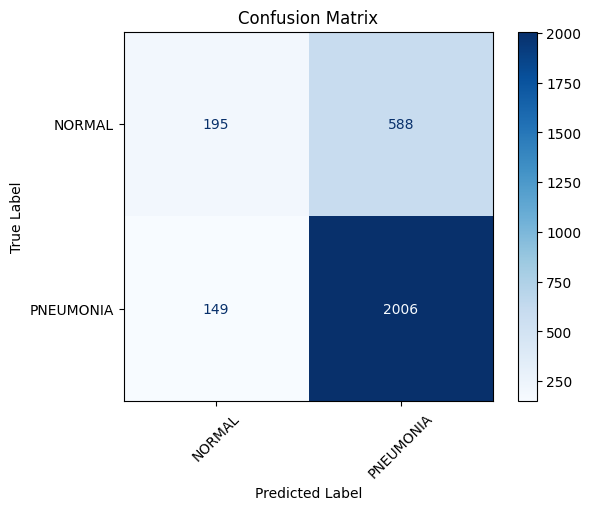

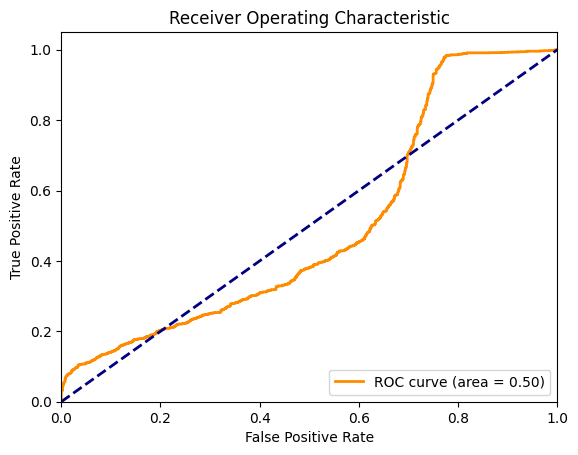

In [19]:
# Classification Report
print("Classification Report:")
print(classification_report(test_labels, y_pred_classes))


from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Calculate confusion matrix
cm = confusion_matrix(test_labels, y_pred_classes)

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_values).plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()


# Plot ROC curve
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(len(class_values)):
    fpr[i], tpr[i], _ = roc_curve(test_labels == i, y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure()
plt.plot(fpr[1], tpr[1], color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc[1])
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()